In [1]:
import skvideo.io
import skvideo.measure
from IPython.display import Video
import matplotlib.pyplot as plt
import numpy as np
import os
import time

# Original Contents (short video)

In [2]:
# pycryptodome: https://pycryptodome.readthedocs.io/en/latest/src/examples.html
# https://pycryptodome.readthedocs.io/en/latest/src/cipher/aes.html
# modern modes: https://pycryptodome.readthedocs.io/en/latest/src/cipher/modern.html

# show video of my dog opening a gate by himself
Video("short.mp4")

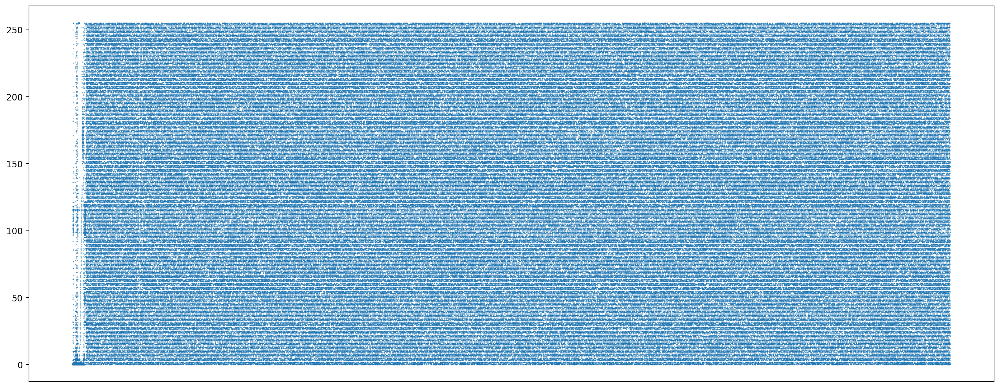

File size: 538865 bytes
Number of frames: 136
Video height: 656 pixels
Video width: 368 pixels
Time duration: 4 seconds


In [3]:
with open('short.mp4', 'rb') as obj:
    raw_bytes = obj.read()    
    
ct_np = np.frombuffer(raw_bytes,dtype=np.uint8)
nx = np.arange(0,len(ct_np))
ny = ct_np
plt.figure(figsize=(20, 8), dpi=200)
plt.scatter(nx, ny, s=0.05)
plt.xticks([])
plt.show()
#print(ct_np)

# reduces to a single luminance channel, necessary to measure similarity between two videos
videodata = skvideo.io.vread("short.mp4", outputdict={"-pix_fmt": "gray"})[:, :, :, 0]

print("File size:", os.path.getsize('short.mp4'), "bytes")
print("Number of frames:",videodata.shape[0])
print("Video height:",videodata.shape[1],"pixels")
print("Video width:",videodata.shape[2],"pixels")
print("Time duration: 4 seconds")

In [4]:
# observe output when performing measurement calculations between the original video and itself
print('original data')
print(videodata)
print('STRRED')
strred = skvideo.measure.strred(videodata, videodata)
print(strred)
print('SSIM')
ssim = skvideo.measure.ssim(videodata, videodata)
print(ssim)
print('MS-SSIM PRODUCT')
msssim_product = skvideo.measure.msssim(videodata, videodata, method='product')
print(msssim_product)
print('MS-SSIM SUM')
msssim_sum = skvideo.measure.msssim(videodata, videodata, method='sum')
print(msssim_sum)
print('MSE')
mse = skvideo.measure.mse(videodata, videodata)
print(mse)
print('PSNR')
psnr = skvideo.measure.psnr(videodata, videodata)
print(psnr)
print('VIIDEO')
viideo_score = skvideo.measure.viideo_score(videodata)
print(viideo_score)

original data
[[[ 23  23  22 ... 134 132 132]
  [ 23  23  22 ... 134 132 132]
  [ 24  24  23 ... 134 132 132]
  ...
  [128 128 129 ... 109 109 109]
  [128 128 129 ... 109 109 109]
  [128 128 129 ... 109 109 109]]

 [[ 14  14  14 ... 133 132 132]
  [ 14  14  14 ... 133 132 132]
  [ 14  14  14 ... 133 132 132]
  ...
  [129 129 130 ... 105 106 105]
  [129 129 130 ... 106 107 111]
  [129 129 130 ... 106 107 108]]

 [[ 31  31  31 ... 133 133 133]
  [ 33  33  33 ... 128 128 128]
  [ 33  33  33 ... 100 101 101]
  ...
  [129 129 130 ... 107 108 108]
  [129 129 130 ... 107 108 107]
  [129 129 130 ... 107 108 107]]

 ...

 [[197 196 196 ... 147 147 147]
  [197 196 196 ... 147 147 147]
  [197 196 196 ... 147 147 147]
  ...
  [114 114 115 ...  92  91  91]
  [114 114 115 ...  92  91  91]
  [114 114 115 ...  92  91  91]]

 [[197 196 196 ... 147 147 147]
  [197 196 196 ... 147 147 147]
  [197 196 196 ... 147 147 147]
  ...
  [114 114 115 ...  92  90  92]
  [114 114 115 ...  92  90  92]
  [114 114 115

/usr/local/lib/python3.9/site-packages/skvideo/measure/psnr.py:55: RuntimeWarning: divide by zero encountered in double_scalars
  psnr = 10 * np.log10(maxsq / mse)


0.59537995


<Figure size 432x288 with 0 Axes>

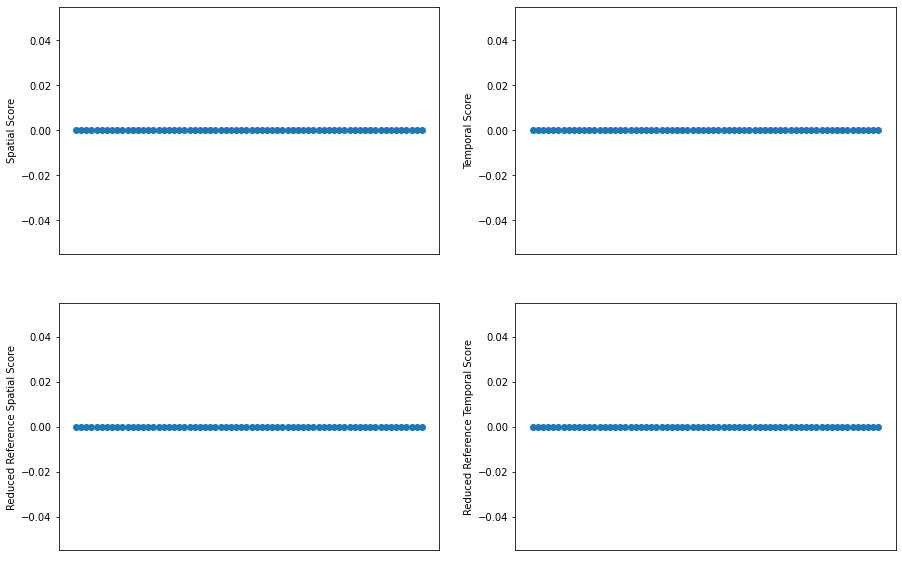

In [5]:
fig = plt.figure()
plt.figure(figsize=(15,10))

plt.subplot(2, 2, 1)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][0])
plt.xticks([])
plt.ylabel('Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 2)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][1])
plt.xticks([])
plt.ylabel('Temporal Score')
plt.scatter(x, y)

plt.subplot(2, 2, 3)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][2])
plt.xticks([])
plt.ylabel('Reduced Reference Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 4)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][3])
plt.xticks([])
plt.ylabel('Reduced Reference Temporal Score')
plt.scatter(x, y)

plt.show()

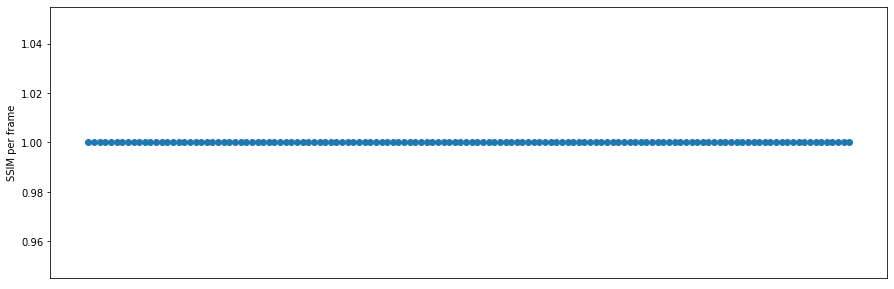

In [6]:
plt.figure(figsize=(15,5))
x = np.arange(0,len(ssim))
y = []
for i in x:
    y.append(ssim[i])
plt.scatter(x, y)
plt.xticks([])
plt.ylabel('SSIM per frame')
plt.show()

<Figure size 432x288 with 0 Axes>

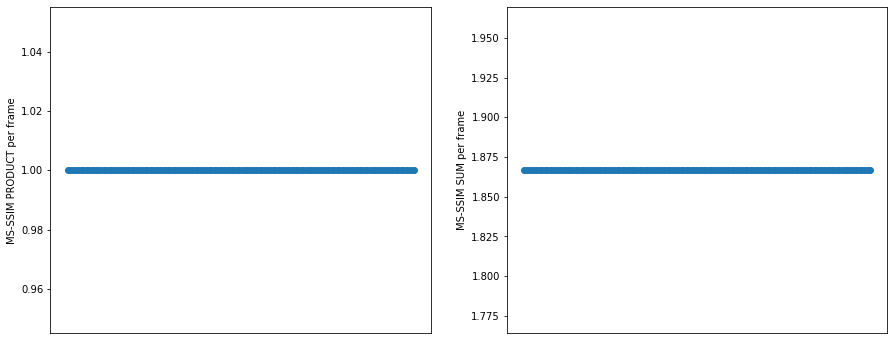

In [7]:
fig = plt.figure()
plt.figure(figsize=(15,6))

plt.subplot(1, 2, 1)
x = np.arange(0,len(msssim_product))
y = []
for i in x:
    y.append(msssim_product[i])
plt.xticks([])
plt.ylabel('MS-SSIM PRODUCT per frame')
plt.scatter(x, y)

plt.subplot(1, 2, 2)
x = np.arange(0,len(msssim_sum))
y = []
for i in x:
    y.append(msssim_sum[i])
plt.xticks([])
plt.ylabel('MS-SSIM SUM per frame')
plt.scatter(x, y)

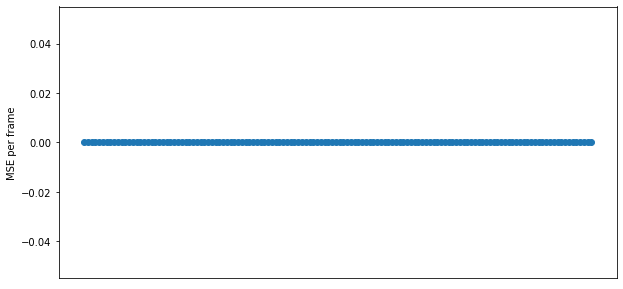

In [8]:
plt.figure(figsize=(10,5))
nx = np.arange(0,len(mse))
ny = []
for i in nx:
    ny.append(mse[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('MSE per frame')
plt.show()

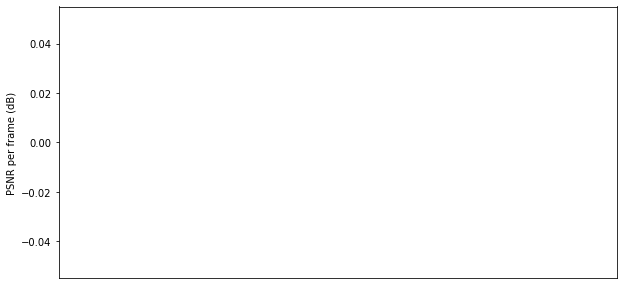

In [9]:
plt.figure(figsize=(10,5))
nx = np.arange(0,len(psnr))
ny = []
for i in nx:
    ny.append(psnr[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('PSNR per frame (dB)')
plt.show()

In [10]:
print("Average SSIM value:", np.mean(ssim))
print("Average MSSSIM product value:", np.mean(msssim_product))
print("Average MSSSIM sum value:", np.mean(msssim_sum))
print("Average MSE value:", np.mean(mse))
print("Average PSNR value: inf")

Average SSIM value: 1.0
Average MSSSIM product value: 1.0
Average MSSSIM sum value: 1.8667134
Average MSE value: 0.0
Average PSNR value: inf


# AES-GCM with a 256-bit key

Time taken to encrypt: 0.003716707229614258 seconds


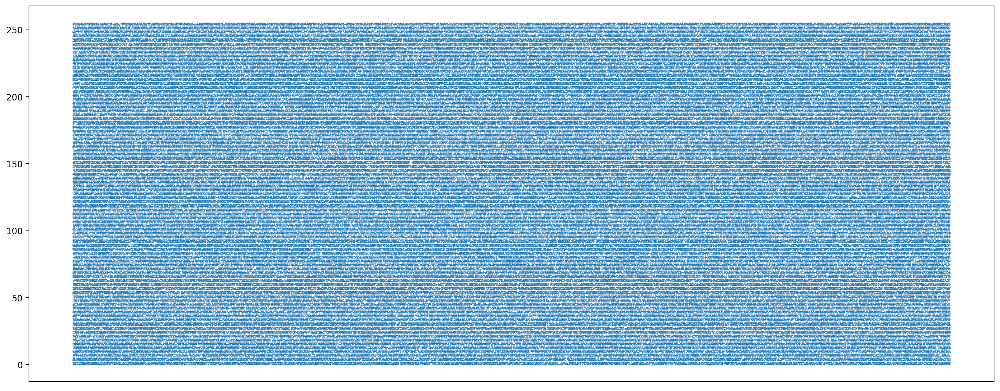

File size: 538865 bytes
Overlapping values: 2150


In [11]:
# Encryption
from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes

t0 = time.time()
key = get_random_bytes(32)
cipher = AES.new(key, AES.MODE_GCM)
modciphertext, tag = cipher.encrypt_and_digest(raw_bytes)
t1 = time.time()
print("Time taken to encrypt:",t1-t0,"seconds")

ct_np = np.frombuffer(modciphertext,dtype=np.uint8)

nx = np.arange(0,len(ct_np))
ny = ct_np
plt.figure(figsize=(20, 8), dpi=200)
plt.scatter(nx, ny, s=0.05)
plt.xticks([])
plt.show()

# Open file in binary write mode
binary_file = open("aes-gcm_shortfile.mp4", "wb")
  
# Write bytes to file
binary_file.write(modciphertext)
  
# Close file
binary_file.close()

print("File size:", os.path.getsize('aes-gcm_shortfile.mp4'), "bytes")
counter = 0
for i in range(1,len(raw_bytes)):
    if (raw_bytes[i] == modciphertext[i]):
        counter += 1
print('Overlapping values:',counter)

In [12]:
encrypted_data = skvideo.io.vread("aes-gcm_shortfile.mp4", height=656, width=368, num_frames=136, outputdict={"-pix_fmt": "gray"})[:, :, :, 0]
print('encrypted data')
print(encrypted_data)
print('STRRED')
strred = skvideo.measure.strred(videodata, encrypted_data)
print(strred)
print('SSIM')
ssim = skvideo.measure.ssim(videodata, encrypted_data)
print(ssim)
print('MS-SSIM PRODUCT')
msssim_product = skvideo.measure.msssim(videodata, encrypted_data, method='product')
print(msssim_product)
print('MS-SSIM SUM')
msssim_sum = skvideo.measure.msssim(videodata, encrypted_data, method='sum')
print(msssim_sum)
print('MSE')
mse = skvideo.measure.mse(videodata, encrypted_data)
print(mse)
print('PSNR')
psnr = skvideo.measure.psnr(videodata, encrypted_data)
print(psnr)
print('VIIDEO')
encrypted_viideo_score = skvideo.measure.viideo_score(encrypted_data)
print(encrypted_viideo_score)

encrypted data
[[[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 ...

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]]
STRRED
(array([[ 74.90189 ,  41.613754,  74.90189 ,  41.613754],
       [ 75.80653 ,  67.32794 ,  75.80653 ,  67.32794 ],
       [ 73.731766, 110.87612 ,  73.731766, 110.87612 ],
       [ 75.08806 ,  56.6625  , 

[0.35954902 0.3615141  0.35859796 0.35860345 0.35380557 0.3460877
 0.34312895 0.34189963 0.3358565  0.33293775 0.32949284 0.33086285
 0.33180752 0.3311929  0.3294973  0.32713038 0.32663646 0.3218775
 0.31737942 0.31482476 0.32281306 0.3285515  0.33026633 0.33097434
 0.33153084 0.3300311  0.33386126 0.33468497 0.33616447 0.33571726
 0.3388868  0.33951867 0.34642446 0.34828827 0.35486427 0.3551827
 0.35654637 0.35802406 0.35989746 0.3576617  0.360914   0.36143506
 0.3642215  0.36185175 0.36393976 0.36312163 0.36342293 0.3600041
 0.36103424 0.3595376  0.36029357 0.35727063 0.3595782  0.35778326
 0.35796008 0.35502347 0.356777   0.35522303 0.35600913 0.35306183
 0.34792873 0.3502473  0.3492246  0.34850317 0.3460513  0.34758773
 0.34686634 0.34657475 0.34443304 0.34807065 0.34559944 0.34597054
 0.3440679  0.34565812 0.34495592 0.34535274 0.34309962 0.34642923
 0.34716138 0.34997344 0.34551847 0.34934223 0.34875673 0.3516538
 0.34667715 0.34846509 0.34677786 0.34701684 0.34398144 0.34568903


<Figure size 432x288 with 0 Axes>

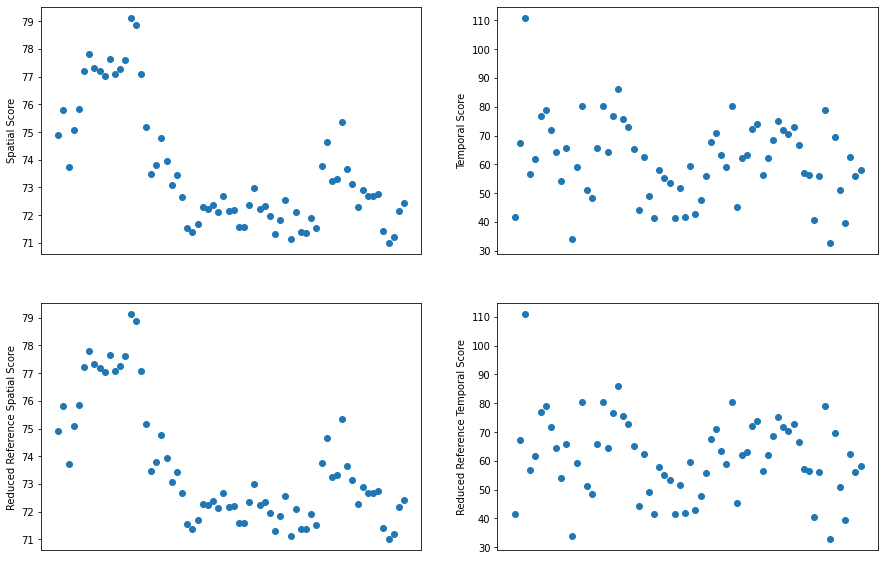

In [13]:
fig = plt.figure()
plt.figure(figsize=(15,10))

plt.subplot(2, 2, 1)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][0])
plt.xticks([])
plt.ylabel('Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 2)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][1])
plt.xticks([])
plt.ylabel('Temporal Score')
plt.scatter(x, y)

plt.subplot(2, 2, 3)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][2])
plt.xticks([])
plt.ylabel('Reduced Reference Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 4)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][3])
plt.xticks([])
plt.ylabel('Reduced Reference Temporal Score')
plt.scatter(x, y)

plt.show()

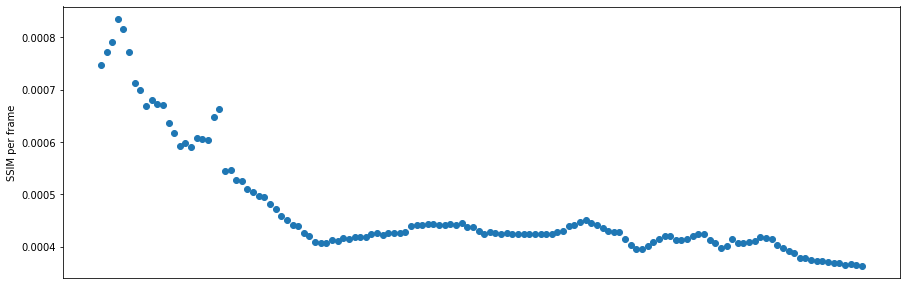

In [14]:
plt.figure(figsize=(15,5))
x = np.arange(0,len(ssim))
y = []
for i in x:
    y.append(ssim[i])
plt.scatter(x, y)
plt.xticks([])
plt.ylabel('SSIM per frame')
plt.show()

<Figure size 432x288 with 0 Axes>

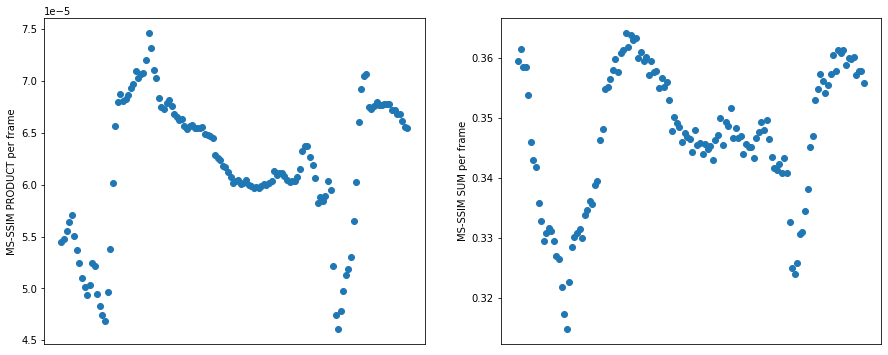

In [15]:
fig = plt.figure()
plt.figure(figsize=(15,6))

plt.subplot(1, 2, 1)
x = np.arange(0,len(msssim_product))
y = []
for i in x:
    y.append(msssim_product[i])
plt.xticks([])
plt.ylabel('MS-SSIM PRODUCT per frame')
plt.scatter(x, y)

plt.subplot(1, 2, 2)
x = np.arange(0,len(msssim_sum))
y = []
for i in x:
    y.append(msssim_sum[i])
plt.xticks([])
plt.ylabel('MS-SSIM SUM per frame')
plt.scatter(x, y)

<Figure size 432x288 with 0 Axes>

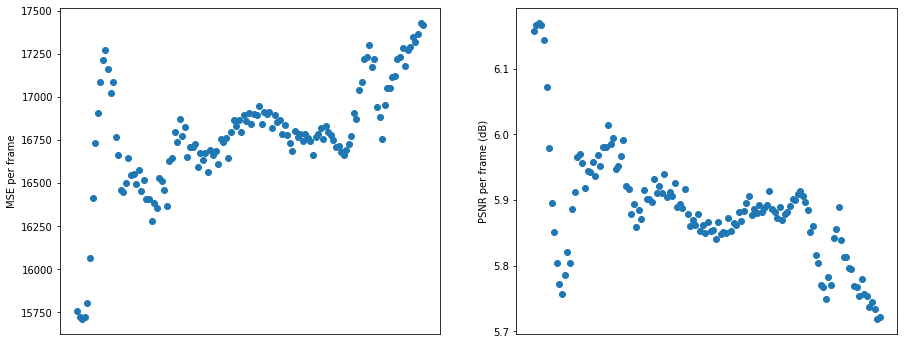

In [16]:
fig = plt.figure()
plt.figure(figsize=(15,6))

plt.subplot(1, 2, 1)
nx = np.arange(0,len(mse))
ny = []
for i in nx:
    ny.append(mse[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('MSE per frame')

plt.subplot(1, 2, 2)
nx = np.arange(0,len(psnr))
ny = []
for i in nx:
    ny.append(psnr[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('PSNR per frame (dB)')
plt.show()

In [17]:
print("Average SSIM value:", np.mean(ssim))
print("Average MSSSIM product value:", np.mean(msssim_product))
print("Average MSSSIM sum value:", np.mean(msssim_sum))
print("Average MSE value:", np.mean(mse))
print("Average PSNR value:", np.mean(psnr))

Average SSIM value: 0.00046678464
Average MSSSIM product value: 6.179787e-05
Average MSSSIM sum value: 0.34697443
Average MSE value: 16776.453
Average PSNR value: 5.884617502983242


In [18]:
# Decryption
t0 = time.time()
d_cipher = AES.new(key, AES.MODE_GCM, cipher.nonce)
decrypted = d_cipher.decrypt_and_verify(modciphertext, tag)
t1 = time.time()
print("Time taken to decrypt:",t1-t0,"seconds")
with open("decrypt_aes-gcm_shortfile.mp4", "wb") as binary_file:
    binary_file.write(decrypted)
# Verify that the original file matches the result
assert(raw_bytes == decrypted)

Time taken to decrypt: 0.0024759769439697266 seconds


# Original Contents (longer video)

In [19]:
# show video of my dog eating spilled food
Video("long.mp4")

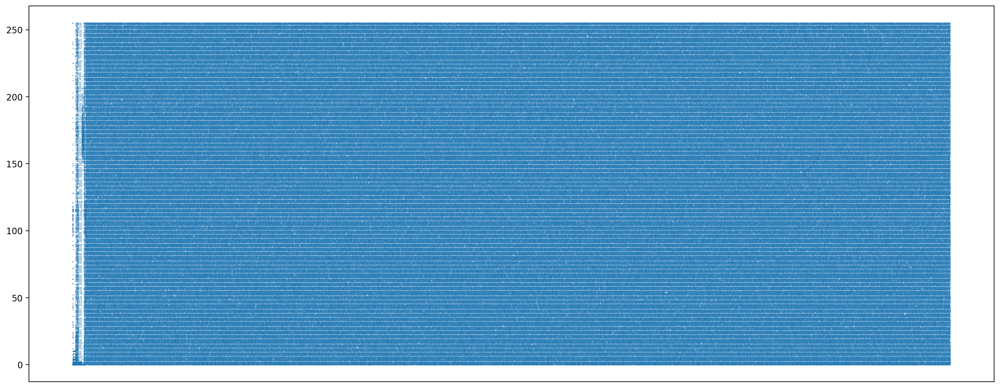

File size: 1837477 bytes
Number of frames: 688
Video height: 656 pixels
Video width: 368 pixels
Time duration: 22 seconds


In [20]:
with open('long.mp4', 'rb') as obj:
    raw_bytes = obj.read()    
    
ct_np = np.frombuffer(raw_bytes,dtype=np.uint8)
nx = np.arange(0,len(ct_np))
ny = ct_np
plt.figure(figsize=(20, 8), dpi=200)
plt.scatter(nx, ny, s=0.05)
plt.xticks([])
plt.show()
#print(ct_np)

# reduces to a single luminance channel, necessary to measure similarity between two videos
videodata = skvideo.io.vread("long.mp4", outputdict={"-pix_fmt": "gray"})[:, :, :, 0]

print("File size:", os.path.getsize('long.mp4'), "bytes")
print("Number of frames:",videodata.shape[0])
print("Video height:",videodata.shape[1],"pixels")
print("Video width:",videodata.shape[2],"pixels")
print("Time duration: 22 seconds")

In [21]:
# observe output when performing measurement calculations between the original video and itself
print('original data')
print(videodata)
print('STRRED')
strred = skvideo.measure.strred(videodata, videodata)
print(strred)
print('SSIM')
ssim = skvideo.measure.ssim(videodata, videodata)
print(ssim)
print('MS-SSIM PRODUCT')
msssim_product = skvideo.measure.msssim(videodata, videodata, method='product')
print(msssim_product)
print('MS-SSIM SUM')
msssim_sum = skvideo.measure.msssim(videodata, videodata, method='sum')
print(msssim_sum)
print('MSE')
mse = skvideo.measure.mse(videodata, videodata)
print(mse)
print('PSNR')
psnr = skvideo.measure.psnr(videodata, videodata)
print(psnr)
print('VIIDEO')
viideo_score = skvideo.measure.viideo_score(videodata)
print(viideo_score)

original data
[[[ 27  27  27 ... 213 213 213]
  [ 27  27  27 ... 213 213 213]
  [ 27  27  27 ... 213 213 213]
  ...
  [ 23  23  23 ...  29  29  29]
  [ 23  23  23 ...  29  29  29]
  [ 23  23  23 ...  29  29  29]]

 [[ 27  27  27 ... 210 220 231]
  [ 27  27  27 ... 218 211 211]
  [ 27  27  27 ... 220 208 201]
  ...
  [ 23  23  23 ...  29  29  29]
  [ 23  23  23 ...  29  29  29]
  [ 23  23  23 ...  29  29  29]]

 [[ 27  27  27 ... 199 226 211]
  [ 27  27  27 ... 201 218 211]
  [ 27  27  27 ... 218 212 212]
  ...
  [ 23  23  23 ...  34  33  33]
  [ 23  23  23 ...  30  30  30]
  [ 23  23  23 ...  29  29  29]]

 ...

 [[ 15  15  15 ... 239 239 239]
  [ 15  15  15 ... 239 239 239]
  [ 16  16  16 ... 239 239 239]
  ...
  [ 29  29  29 ...  52  50  49]
  [ 29  29  29 ...  52  50  49]
  [ 29  29  29 ...  52  50  49]]

 [[ 17  17  16 ... 239 239 239]
  [ 20  19  16 ... 239 239 239]
  [ 20  19  16 ... 239 239 239]
  ...
  [ 29  29  29 ...  51  49  49]
  [ 29  29  29 ...  51  49  49]
  [ 29  29  29

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

<Figure size 432x288 with 0 Axes>

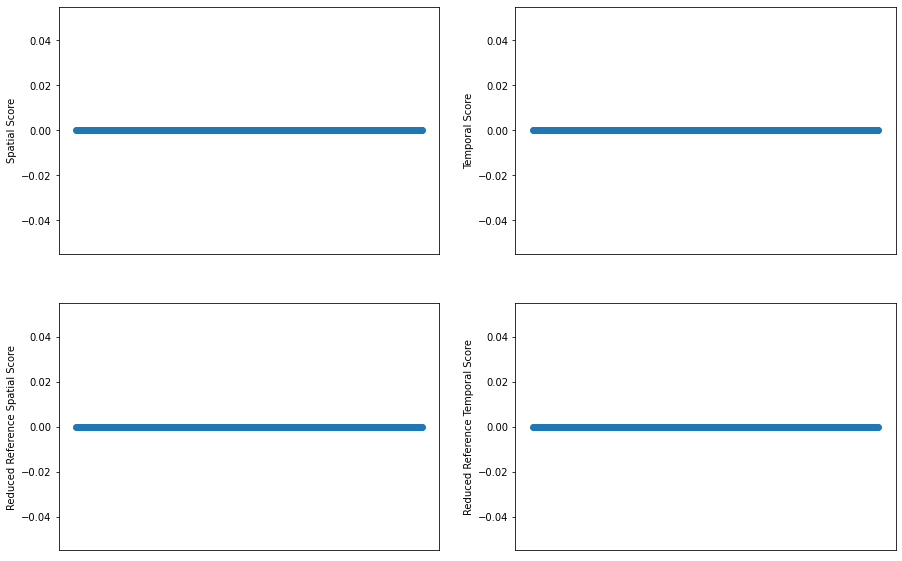

In [22]:
fig = plt.figure()
plt.figure(figsize=(15,10))

plt.subplot(2, 2, 1)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][0])
plt.xticks([])
plt.ylabel('Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 2)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][1])
plt.xticks([])
plt.ylabel('Temporal Score')
plt.scatter(x, y)

plt.subplot(2, 2, 3)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][2])
plt.xticks([])
plt.ylabel('Reduced Reference Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 4)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][3])
plt.xticks([])
plt.ylabel('Reduced Reference Temporal Score')
plt.scatter(x, y)

plt.show()

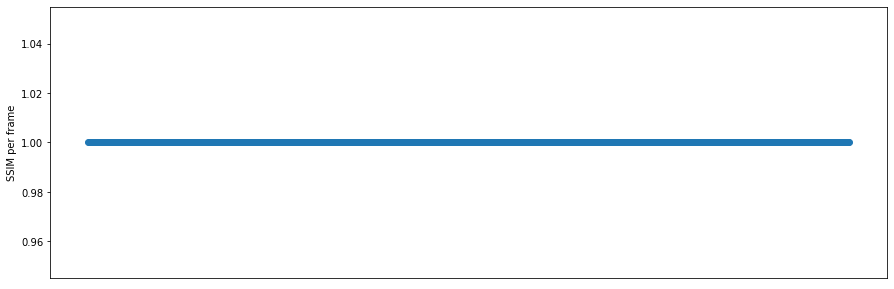

In [23]:
plt.figure(figsize=(15,5))
x = np.arange(0,len(ssim))
y = []
for i in x:
    y.append(ssim[i])
plt.scatter(x, y)
plt.xticks([])
plt.ylabel('SSIM per frame')
plt.show()

<Figure size 432x288 with 0 Axes>

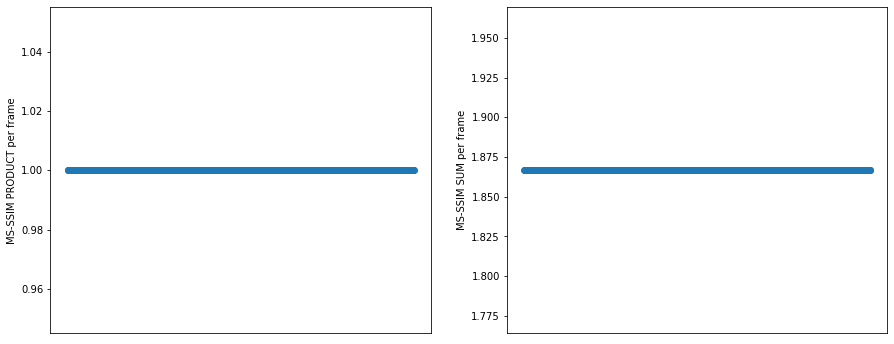

In [24]:
fig = plt.figure()
plt.figure(figsize=(15,6))

plt.subplot(1, 2, 1)
x = np.arange(0,len(msssim_product))
y = []
for i in x:
    y.append(msssim_product[i])
plt.xticks([])
plt.ylabel('MS-SSIM PRODUCT per frame')
plt.scatter(x, y)

plt.subplot(1, 2, 2)
x = np.arange(0,len(msssim_sum))
y = []
for i in x:
    y.append(msssim_sum[i])
plt.xticks([])
plt.ylabel('MS-SSIM SUM per frame')
plt.scatter(x, y)

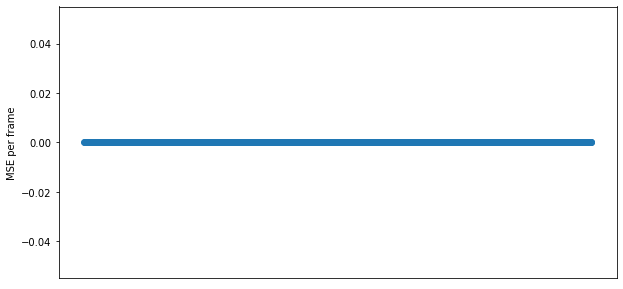

In [25]:
plt.figure(figsize=(10,5))
nx = np.arange(0,len(mse))
ny = []
for i in nx:
    ny.append(mse[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('MSE per frame')
plt.show()

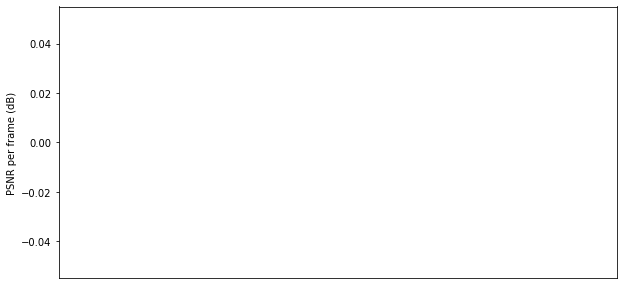

In [26]:
plt.figure(figsize=(10,5))
nx = np.arange(0,len(psnr))
ny = []
for i in nx:
    ny.append(psnr[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('PSNR per frame (dB)')
plt.show()

In [27]:
print("Average SSIM value:", np.mean(ssim))
print("Average MSSSIM product value:", np.mean(msssim_product))
print("Average MSSSIM sum value:", np.mean(msssim_sum))
print("Average MSE value:", np.mean(mse))
print("Average PSNR value: inf")

Average SSIM value: 1.0
Average MSSSIM product value: 1.0
Average MSSSIM sum value: 1.8667134
Average MSE value: 0.0
Average PSNR value: inf


# AES-GCM with a 256-bit key

Time taken to encrypt: 0.006269216537475586 seconds


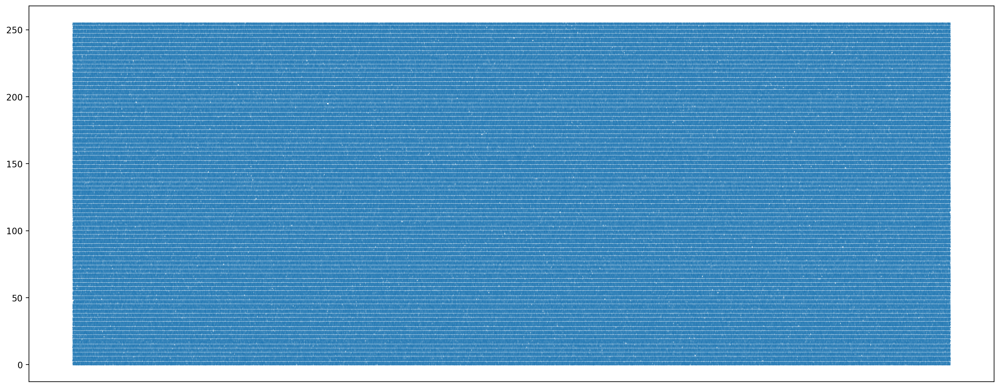

File size: 1837477 bytes
Overlapping values: 7063


In [28]:
# Encryption
from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes

t0 = time.time()
key = get_random_bytes(32)
cipher = AES.new(key, AES.MODE_GCM)
modciphertext, tag = cipher.encrypt_and_digest(raw_bytes)
t1 = time.time()
print("Time taken to encrypt:",t1-t0,"seconds")

ct_np = np.frombuffer(modciphertext,dtype=np.uint8)

nx = np.arange(0,len(ct_np))
ny = ct_np
plt.figure(figsize=(20, 8), dpi=200)
plt.scatter(nx, ny, s=0.05)
plt.xticks([])
plt.show()

# Open file in binary write mode
binary_file = open("aes-gcm_longfile.mp4", "wb")
  
# Write bytes to file
binary_file.write(modciphertext)
  
# Close file
binary_file.close()

print("File size:", os.path.getsize('aes-gcm_longfile.mp4'), "bytes")

counter = 0
for i in range(1,len(raw_bytes)):
    if (raw_bytes[i] == modciphertext[i]):
        counter += 1
print('Overlapping values:',counter)

In [29]:
encrypted_data = skvideo.io.vread("aes-gcm_longfile.mp4", height=656, width=368, num_frames=688, outputdict={"-pix_fmt": "gray"})[:, :, :, 0]
print('encrypted data')
print(encrypted_data)
print('STRRED')
strred = skvideo.measure.strred(videodata, encrypted_data)
print(strred)
print('SSIM')
ssim = skvideo.measure.ssim(videodata, encrypted_data)
print(ssim)
print('MS-SSIM PRODUCT')
msssim_product = skvideo.measure.msssim(videodata, encrypted_data, method='product')
print(msssim_product)
print('MS-SSIM SUM')
msssim_sum = skvideo.measure.msssim(videodata, encrypted_data, method='sum')
print(msssim_sum)
print('MSE')
mse = skvideo.measure.mse(videodata, encrypted_data)
print(mse)
print('PSNR')
psnr = skvideo.measure.psnr(videodata, encrypted_data)
print(psnr)
print('VIIDEO')
encrypted_viideo_score = skvideo.measure.viideo_score(encrypted_data)
print(encrypted_viideo_score)

encrypted data
[[[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 ...

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]

 [[0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  ...
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]
  [0 0 0 ... 0 0 0]]]
STRRED
(array([[ 75.83465 ,  69.92338 ,  75.83465 ,  69.92338 ],
       [ 77.53528 ,  97.07702 ,  77.53528 ,  97.07702 ],
       [ 74.92129 ,  88.46539 ,  74.92129 ,  88.46539 ],
       ...,
       [ 74.19627 , 

[4.2707357e-05 4.1368676e-05 4.0787399e-05 4.1223884e-05 4.1234336e-05
 4.1737640e-05 4.1264557e-05 4.1134455e-05 4.1955245e-05 4.2810225e-05
 4.3288863e-05 4.2962587e-05 4.3396423e-05 4.4651082e-05 4.6569407e-05
 4.8311442e-05 5.0074563e-05 5.1091174e-05 5.2096257e-05 5.3668464e-05
 5.5786568e-05 5.7523412e-05 5.9502967e-05 5.7728270e-05 5.7209512e-05
 5.3933043e-05 5.1735402e-05 4.9558941e-05 4.8782320e-05 4.7768408e-05
 4.7120757e-05 4.6539350e-05 4.5357370e-05 4.3844899e-05 4.2615895e-05
 4.1675881e-05 4.1037481e-05 3.9873292e-05 3.9923390e-05 4.0909374e-05
 4.1577368e-05 4.0836734e-05 4.0451072e-05 3.9739993e-05 3.9755141e-05
 3.9737839e-05 4.0136270e-05 3.9965256e-05 4.0086401e-05 4.0708725e-05
 4.1861083e-05 4.2756976e-05 4.5177883e-05 4.8450871e-05 5.4436656e-05
 5.8819831e-05 6.3388637e-05 6.5872227e-05 6.6151450e-05 6.5470420e-05
 6.5159235e-05 6.5032473e-05 6.4813736e-05 6.4698055e-05 6.5426721e-05
 6.6201916e-05 6.7292771e-05 6.7584137e-05 6.8740832e-05 6.7616202e-05
 6.648

[0.39762887 0.40077692 0.40247655 0.4009694  0.40420267 0.40203002
 0.40472344 0.40881717 0.41094723 0.41303512 0.41524497 0.4156601
 0.4150316  0.4176201  0.42106912 0.4259792  0.4314992  0.43798715
 0.4442097  0.44469237 0.44794586 0.45192418 0.45349067 0.45232087
 0.453318   0.4477245  0.44664097 0.44126064 0.43961257 0.43514004
 0.43108568 0.4305775  0.4282715  0.42294422 0.42209402 0.42186743
 0.4186133  0.4180479  0.41564792 0.41702262 0.41365948 0.4135931
 0.41146043 0.41197675 0.40963566 0.40908024 0.40548167 0.40479308
 0.40577775 0.40487725 0.40904677 0.41482595 0.4231578  0.4288772
 0.4361003  0.43587306 0.4371899  0.43700898 0.43818384 0.43793264
 0.4328444  0.4351707  0.43243188 0.4309678  0.42806157 0.43052456
 0.4289514  0.42887664 0.4256826  0.42880568 0.42819184 0.42693934
 0.42220432 0.42548084 0.42530206 0.42534503 0.42181608 0.4251147
 0.42328936 0.42270094 0.41995418 0.42222273 0.42033422 0.4207163
 0.41814905 0.42009532 0.41923562 0.419324   0.4176134  0.41964614


[6.5737703  6.56470447 6.59042007 6.64247608 6.68031017 6.72741142
 6.72421993 6.70548129 6.72121008 6.70592248 6.7283929  6.69606934
 6.71775783 6.73048704 6.78508905 6.83029984 6.89986868 6.92006334
 6.95902423 6.99741325 7.04765974 7.03716091 7.0691822  7.03367519
 7.03076232 6.95863846 6.90160299 6.84405062 6.82602381 6.82520445
 6.83367045 6.8164154  6.7777943  6.74263342 6.71713032 6.69275028
 6.68214444 6.63294909 6.64135375 6.63482863 6.65669892 6.64242299
 6.65363462 6.63123191 6.64214059 6.63551182 6.66356861 6.65152062
 6.65377654 6.68241528 6.70467052 6.72470699 6.7893532  6.85282178
 6.90579493 6.99225823 7.02684748 7.02844496 7.02293922 7.03379974
 7.06720907 7.06638401 7.09335538 7.09858001 7.12338311 7.09969045
 7.10556323 7.08402338 7.11139255 7.08387312 7.08720459 7.07009272
 7.09719334 7.09075842 7.10868846 7.09339835 7.11031676 7.09416514
 7.10159746 7.09398814 7.11302801 7.08843543 7.09301691 7.08744528
 7.11750647 7.10872069 7.11842356 7.11293831 7.12742674 7.1037

<Figure size 432x288 with 0 Axes>

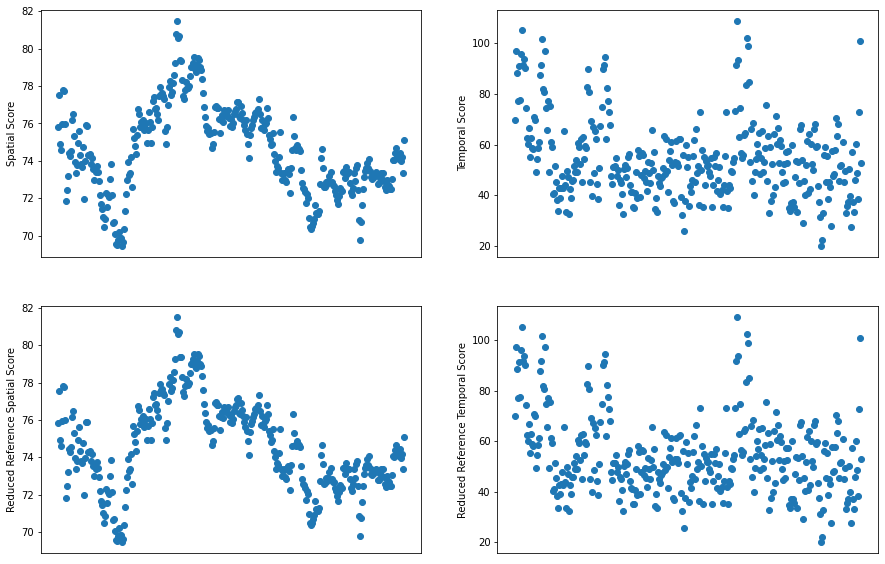

In [30]:
fig = plt.figure()
plt.figure(figsize=(15,10))

plt.subplot(2, 2, 1)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][0])
plt.xticks([])
plt.ylabel('Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 2)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][1])
plt.xticks([])
plt.ylabel('Temporal Score')
plt.scatter(x, y)

plt.subplot(2, 2, 3)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][2])
plt.xticks([])
plt.ylabel('Reduced Reference Spatial Score')
plt.scatter(x, y)

plt.subplot(2, 2, 4)
x = np.arange(0,len(strred[0]))
y = []
for i in x:
    y.append(strred[0][i][3])
plt.xticks([])
plt.ylabel('Reduced Reference Temporal Score')
plt.scatter(x, y)

plt.show()

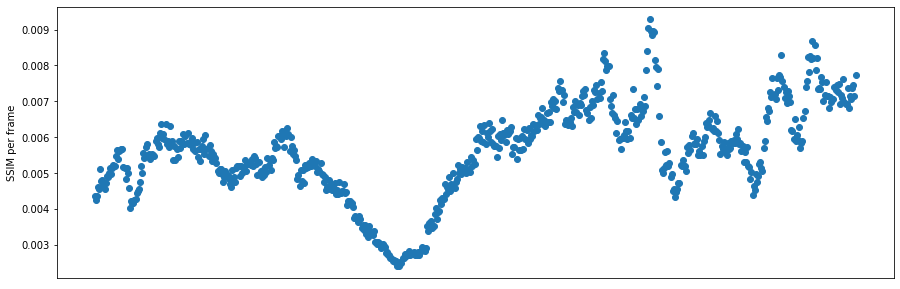

In [31]:
plt.figure(figsize=(15,5))
x = np.arange(0,len(ssim))
y = []
for i in x:
    y.append(ssim[i])
plt.scatter(x, y)
plt.xticks([])
plt.ylabel('SSIM per frame')
plt.show()

<Figure size 432x288 with 0 Axes>

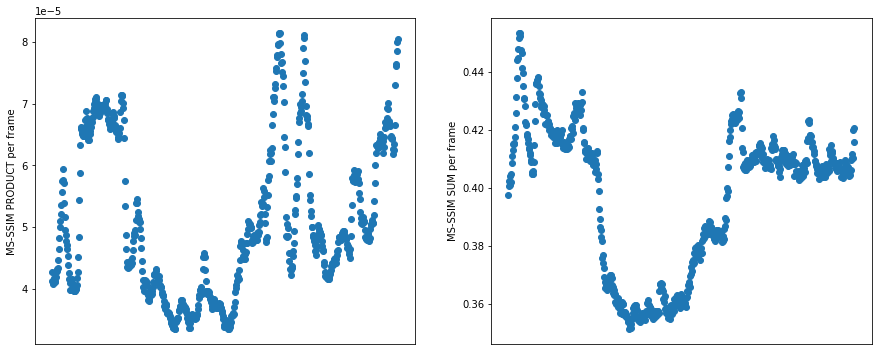

In [32]:
fig = plt.figure()
plt.figure(figsize=(15,6))

plt.subplot(1, 2, 1)
x = np.arange(0,len(msssim_product))
y = []
for i in x:
    y.append(msssim_product[i])
plt.xticks([])
plt.ylabel('MS-SSIM PRODUCT per frame')
plt.scatter(x, y)

plt.subplot(1, 2, 2)
x = np.arange(0,len(msssim_sum))
y = []
for i in x:
    y.append(msssim_sum[i])
plt.xticks([])
plt.ylabel('MS-SSIM SUM per frame')
plt.scatter(x, y)

<Figure size 432x288 with 0 Axes>

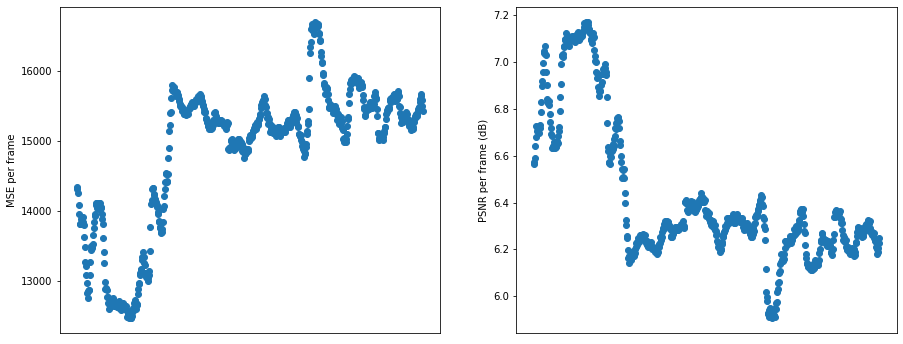

In [33]:
fig = plt.figure()
plt.figure(figsize=(15,6))

plt.subplot(1, 2, 1)
nx = np.arange(0,len(mse))
ny = []
for i in nx:
    ny.append(mse[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('MSE per frame')

plt.subplot(1, 2, 2)
nx = np.arange(0,len(psnr))
ny = []
for i in nx:
    ny.append(psnr[i])
plt.scatter(nx, ny)
plt.xticks([])
plt.ylabel('PSNR per frame (dB)')
plt.show()

In [34]:
print("Average SSIM value:", np.mean(ssim))
print("Average MSSSIM product value:", np.mean(msssim_product))
print("Average MSSSIM sum value:", np.mean(msssim_sum))
print("Average MSE value:", np.mean(mse))
print("Average PSNR value:", np.mean(psnr))

Average SSIM value: 0.0055872994
Average MSSSIM product value: 5.0962273e-05
Average MSSSIM sum value: 0.39712977
Average MSE value: 14856.846
Average PSNR value: 6.422349129838881


In [38]:
# Decryption
t0 = time.time()
d_cipher = AES.new(key, AES.MODE_GCM, cipher.nonce)
decrypted = d_cipher.decrypt_and_verify(modciphertext, tag)
t1 = time.time()
print("Time taken to decrypt:",t1-t0,"seconds")
with open("decrypt_aes-gcm_longfile.mp4", "wb") as binary_file:
    binary_file.write(decrypted)
# Verify that the original file matches the result
assert(raw_bytes == decrypted)

Time taken to decrypt: 0.010535001754760742 seconds


In [39]:
print(skvideo.measure.niqe(videodata))

AttributeError: module 'scipy.misc' has no attribute 'imresize'

sk-video 1.1.10
ipython 7.25.0
matplotlib 3.4.2
numpy 1.21.0